# Установка библиотек

In [1]:
import torch
import random
import numpy as np


def set_seed(seed=42):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    random.seed(seed)
    np.random.seed(seed)

In [2]:
import timm
import torch
import torchmetrics
import numpy as np
import pandas as pd
import torch.nn as nn
import matplotlib.pyplot as plt
import lightning as L

from tqdm.notebook import trange, tqdm
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from sklearn.model_selection import train_test_split

from torchmetrics import MetricCollection
from torchmetrics.classification import (
    MulticlassAccuracy,
    MulticlassF1Score,
    MulticlassAUROC,
)

set_seed(42)
L.seed_everything(42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Seed set to 42


# Подготовка данных

## Скачивание

In [3]:
import os
from os import remove
import zipfile
import requests
from urllib.parse import urlencode

In [ ]:
# 299x224 1d big dataset

base_url = 'https://cloud-api.yandex.net/v1/disk/public/resources/download?'
public_key = # 

final_url = base_url + urlencode(dict(public_key=public_key))
response = requests.get(final_url)
download_url = response.json()['href']
response = requests.get(download_url)

dist_path = os.getcwd() + '/Dataset_60x_224_big_v2.zip'
with open(dist_path, 'wb') as f:
    f.write(response.content)

In [6]:
dataset_60x_224_zipfile = os.getcwd() + '/Dataset_60x_224_big_v2.zip'
dataset_60x_224_path = os.getcwd()

with zipfile.ZipFile(dataset_60x_224_zipfile, 'r') as zip_ref:
    zip_ref.extractall(dataset_60x_224_path)

remove(dataset_60x_224_zipfile)

In [7]:
os.listdir(os.getcwd())

['.ipynb_checkpoints',
 'main.ipynb',
 'Dataset_60x_224',
 'Dataset_60x_224_big',
 'lightning_logs',
 'Dataset_60x_224_big_v2']

## Создание датасета

In [4]:
import os
import pandas as pd
from torchvision.io import read_image

In [5]:
class CustomImageDataset(Dataset):
    def __init__(self, annotations_file, img_dir, transform=None, target_transform=None):
        self.img_labels = pd.read_csv(annotations_file)
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[idx, 0])
        image = read_image(img_path)
        label = self.img_labels.iloc[idx, 1]
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

In [6]:
def get_mean_std(loader):
    channels_sum, channels_square_sum, num_batches = 0, 0, 0

    for data, _ in tqdm(loader):
        channels_sum += torch.mean(data, dim=[])
        channels_square_sum += torch.mean(data**2, dim = [0,2,3])
        num_batches += 1

    mean = channels_sum / num_batches
    std = torch.sqrt(channels_square_sum / num_batches - mean**2)

    return mean, std


def get_train_mean_and_std(dataset_path):
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.ToTensor()
    ])

    annotations_file = f"{dataset_path}/annotations_train.csv"
    train_data = CustomImageDataset(annotations_file=annotations_file, img_dir=dataset_path, transform=preprocess)
    train_loader = DataLoader(dataset=train_data, batch_size=64, shuffle=False)
    
    mean, std = get_mean_std(train_loader)
    print("Mean:", mean)
    print("Std: ", std)


def show(img, label_1, num, label_2=""):
    ax = plt.subplot(3, 3, num + 1)
    plt.imshow(img, cmap='gray')
    plt.title(label_1)
    ax.set_xlabel(label_2)
    plt.axis("off")


def show_dataset(dataset_path, dataset="train"):
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.RandomCrop(size=224),
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.RandomVerticalFlip(p=0.5),
        transforms.ToTensor(),
        transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.1)
    ])

    annotations_file = f"{dataset_path}/annotations_{dataset}.csv"
    dataset = CustomImageDataset(annotations_file=annotations_file, img_dir=dataset_path, transform=preprocess)
    id2label = {0: "normal", 1: "glytar", 2: "dextran"}
    
    length = len(dataset)
    plt.rcParams["figure.figsize"] = (15, 15)
    for i in range(9):
        idx = np.random.randint(0, length)
        img, label = dataset[idx]
        name = id2label[label]
        show(img.squeeze(), name, i)


def show_classes(dataset_path, dataset="train"):
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.RandomCrop(size=224),
        # transforms.RandomHorizontalFlip(p=0.5),
        # transforms.RandomVerticalFlip(p=0.5),
        transforms.ToTensor(),
        # transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.1)
    ])

    annotations_file = f"{dataset_path}/annotations_{dataset}.csv"
    dataset = CustomImageDataset(annotations_file=annotations_file, img_dir=dataset_path, transform=preprocess)
    id2label = {0: "normal", 1: "glytar", 2: "dextran"}
    
    plt.rcParams["figure.figsize"] = (15, 15)
    for class_id, label in id2label.items():
        get_class_id = lambda elmnt: elmnt[1] == class_id
        subset = list(filter(get_class_id, dataset))
        length = len(subset)
        idx = np.random.randint(0, length)
        img, _ = subset[idx]
        name = id2label[class_id]
        show(img.squeeze(), name, class_id)

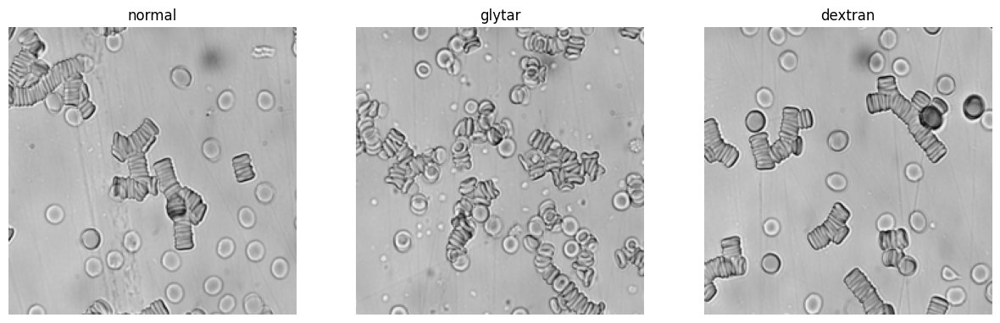

In [8]:
show_classes(f'{os.getcwd()}/Dataset_60x_224_big_v2')

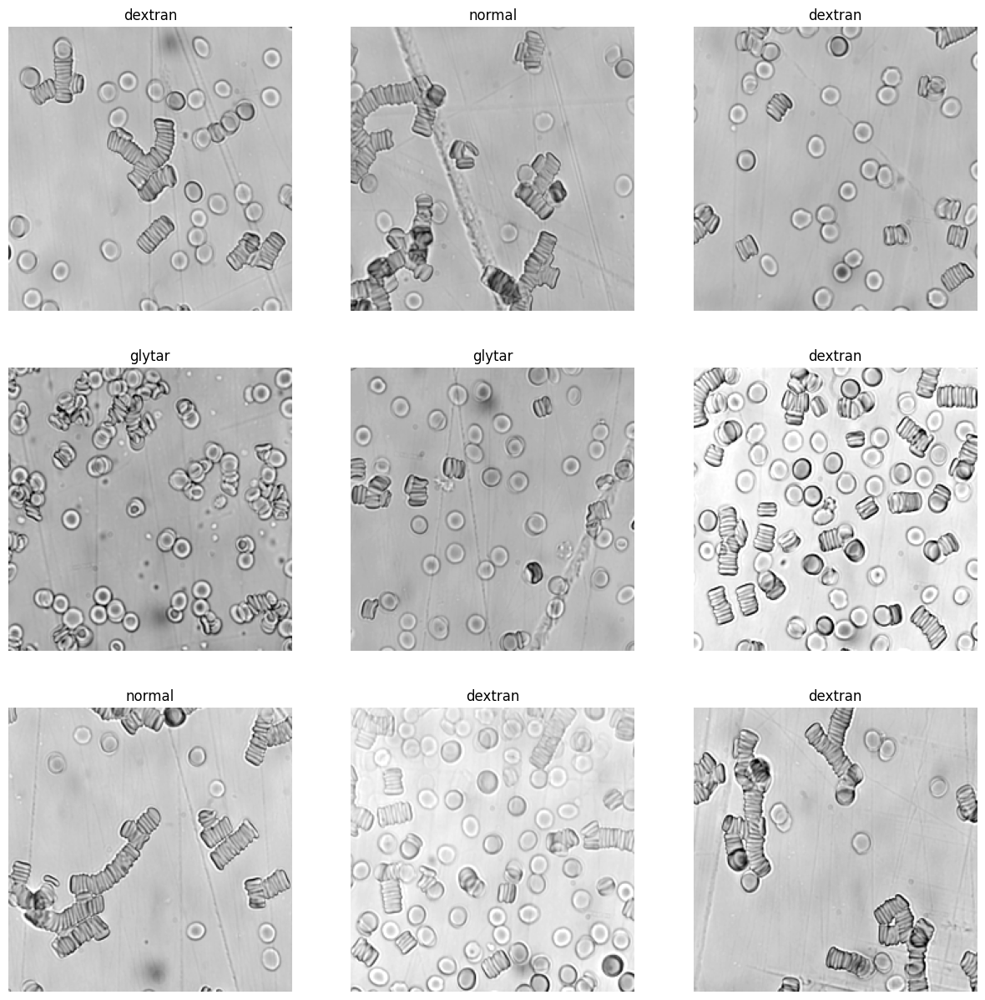

In [12]:
show_dataset(f'{os.getcwd()}/Dataset_60x_224_big_v2')

In [13]:
get_train_mean_and_std(f'{os.getcwd()}/Dataset_60x_224_big_v2')

  0%|          | 0/29 [00:00<?, ?it/s]

Mean: tensor(0.6868)
Std:  tensor([0.1052])


In [7]:
mean = 0.6868
std = 0.1052

preprocess_train = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomCrop(size=224),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.1),
    transforms.Normalize(mean, std),
])

preprocess_val = transforms.Compose([
    transforms.ToPILImage(),
    transforms.CenterCrop(size=224),
    transforms.ToTensor(),
    transforms.Normalize(mean, std),
])

main_path = os.getcwd()

annotations_file = f"{main_path}/Dataset_60x_224_big_v2/annotations_train.csv"
dataset_path = f"{main_path}/Dataset_60x_224_big_v2"
train_data_60x_224 = CustomImageDataset(annotations_file=annotations_file, img_dir=dataset_path, transform=preprocess_train)

annotations_file = f"{main_path}/Dataset_60x_224_big_v2/annotations_val.csv"
dataset_path = f"{main_path}/Dataset_60x_224_big_v2"
val_data_60x_224 = CustomImageDataset(annotations_file=annotations_file, img_dir=dataset_path, transform=preprocess_val)

annotations_file = f"{main_path}/Dataset_60x_224_big_v2/annotations_test.csv"
dataset_path = f"{main_path}/Dataset_60x_224_big_v2"
test_data_60x_224 = CustomImageDataset(annotations_file=annotations_file, img_dir=dataset_path, transform=preprocess_val)

In [8]:
batch_size = 64

train_dataloader_60x_224 = DataLoader(train_data_60x_224, batch_size=batch_size, shuffle=True)
val_dataloader_60x_224 = DataLoader(val_data_60x_224, batch_size=batch_size, shuffle=False)
test_dataloader_60x_224 = DataLoader(test_data_60x_224, batch_size=batch_size, shuffle=False)

In [9]:
len(train_data_60x_224)

1819

In [10]:
len(val_data_60x_224)

859

In [11]:
len(test_data_60x_224)

451

In [15]:
id2label = {0: "normal", 1: "glytar", 2: "dextran"}

# Обучение модели

In [9]:
class LModel(L.LightningModule):
    def __init__(self, model, lr=0.004, weight_decay=0.05):
        super().__init__()
        self.save_hyperparameters(logger=False)

        # for optimizer and shaduler
        self.lr = lr
        self.weight_decay = weight_decay

        # model
        self.model = model
        self.criterion = nn.CrossEntropyLoss()

        # metrics
        self.metrics = MetricCollection(
            [
                MulticlassAccuracy(num_classes=3),
                MulticlassF1Score(num_classes=3),
                MulticlassAUROC(num_classes=3)
            ]
        )
        self.train_metrics = self.metrics.clone(postfix="/train")
        self.val_metrics = self.metrics.clone(postfix="/val")

    def configure_optimizers(self):
        # set optimizer
        optimizer = torch.optim.Adam(
            self.model.parameters(),
            lr=self.lr,
            # weight_decay=self.weight_decay - for adamW
        )
        scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.5)
        # scheduler = torch.optim.lr_scheduler.LinearLR(optimizer)
        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": scheduler,
                "interval": "epoch",  # or 'step'
                "monitor": "loss/val",  # only for self.log
            },
        }

    def training_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.train_metrics.update(out.softmax(-1), y)
        self.log("loss/trian", loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        loss = self.criterion(out, y)
        self.log("loss/val", loss, prog_bar=True)
        self.val_metrics.update(out.softmax(-1), y)
        
    def test_step(self, batch, batch_idx):
        x, y = batch
        out = self.model(x)
        self.metrics.update(out.softmax(-1), y)

    def on_train_epoch_end(self):
        self.log_dict(self.train_metrics.compute())
        self.train_metrics.reset()

    def on_validation_epoch_end(self):
        self.log_dict(self.val_metrics.compute())
        self.val_metrics.reset()

    def on_test_epoch_end(self):
        self.log_dict(self.metrics.compute())
        self.metrics.reset()

In [50]:
model_name = "efficientnet_lite0.ra_in1k"
# model_name = 'resnet18.a2_in1k'
# model_name = 'resnet50.a1_in1k'
# model_name = 'efficientnetv2_rw_t.ra2_in1k'
# model_name = 'convnext_atto.d2_in1k' # lr = 0.00005 !
# model_name = 'convnextv2_atto.fcmae_ft_in1k' # lr = 0.00005 !
# model_name = 'convnextv2_femto.fcmae_ft_in1k' # lr = 0.00005 !
# model_name = 'mobilenetv2_100.ra_in1k'
# model_name = 'mobilenetv4_conv_small.e1200_r224_in1k'
# model_name = 'senet154.gluon_in1k'
# model_name = 'densenet121.ra_in1k'

model = timm.create_model(model_name, pretrained=True, num_classes=3, in_chans=1)

In [51]:
from lightning.pytorch.callbacks import ModelCheckpoint
from lightning.pytorch.loggers import TensorBoardLogger

max_epochs = 20
pl_model = LModel(model)

checkpoint_callback = ModelCheckpoint(
    monitor="MulticlassAccuracy/val", mode="max", filename="best"
)
checkpoint_callback_2 = ModelCheckpoint(
    monitor="MulticlassAccuracy/train", save_last=True
)

logger = TensorBoardLogger(save_dir=f"lightning_logs", name=model_name + "_tuned")

trainer = L.Trainer(
    logger=logger,
    max_epochs=max_epochs,
    accelerator="gpu",
    num_sanity_val_steps=0,
    callbacks=[checkpoint_callback, checkpoint_callback_2]
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [52]:
trainer.fit(
    model=pl_model,
    train_dataloaders=train_dataloader_60x_224,
    val_dataloaders=val_dataloader_60x_224
)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name          | Type             | Params | Mode 
-----------------------------------------------------------
0 | model         | EfficientNet     | 3.4 M  | train
1 | criterion     | CrossEntropyLoss | 0      | train
2 | metrics       | MetricCollection | 0      | train
3 | train_metrics | MetricCollection | 0      | train
4 | val_metrics   | MetricCollection | 0      | train
-----------------------------------------------------------
3.4 M     Trainable params
0         Non-trainable params
3.4 M     Total params
13.497    Total estimated model params size (MB)
286       Modules in train mode
0         Modules in eval mode


Epoch 0: 100%|██████████| 29/29 [00:12<00:00,  2.27it/s, v_num=3, loss/trian=0.604]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 1: 100%|██████████| 29/29 [00:11<00:00,  2.60it/s, v_num=3, loss/trian=0.556, loss/val=3.930]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 2: 100%|██████████| 29/29 [00:11<00:00,  2.61it/s, v_num=3, loss/trian=0.219, loss/val=0.766]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 3: 100%|██████████| 29/29 [00:11<00:00,  2.60it/s, v_num=3, loss/trian=0.842, loss/val=0.470] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 4: 100%|██████████| 29/29 [00:11<00:00,  2.59it/s, v_num=3, loss/trian=0.0747, loss/val=0.735]
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 5: 100%|██████████| 29/29 [00:11<00:00,  2.59it/s, v_num=3, loss/trian=0.106, loss/val=0.650] 
Validation: |          | 0/? [00:00<?, ?it/s]
Epoch 6: 100%|██████████| 29/29 [00:11<00:00,  2.57it/s, v_num=3, loss/trian=0.0433, loss/val=0.781]
Validation: |          | 0/? [00:00<

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 19: 100%|██████████| 29/29 [00:14<00:00,  2.06it/s, v_num=3, loss/trian=0.0219, loss/val=0.334]


In [53]:
trainer.test(
    dataloaders=test_dataloader_60x_224,
    ckpt_path="best"
)

Restoring states from the checkpoint path at lightning_logs/efficientnet_lite0.ra_in1k_tuned/version_3/checkpoints/best.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from the checkpoint at lightning_logs/efficientnet_lite0.ra_in1k_tuned/version_3/checkpoints/best.ckpt


Testing DataLoader 0: 100%|██████████| 8/8 [00:01<00:00,  5.42it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      MulticlassAUROC      │    0.8491401076316833     │
│    MulticlassAccuracy     │     0.604036271572113     │
│     MulticlassF1Score     │    0.5247620940208435     │
└───────────────────────────┴───────────────────────────┘

[{'MulticlassAccuracy': 0.604036271572113,
  'MulticlassF1Score': 0.5247620940208435,
  'MulticlassAUROC': 0.8491401076316833}]

In [54]:
trainer.test(
    dataloaders=test_dataloader_60x_224,
    ckpt_path="last"
)

Restoring states from the checkpoint path at /home/jupyter/work/resources/lightning_logs/efficientnet_lite0.ra_in1k_tuned/version_3/checkpoints/last.ckpt
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loaded model weights from the checkpoint at /home/jupyter/work/resources/lightning_logs/efficientnet_lite0.ra_in1k_tuned/version_3/checkpoints/last.ckpt


Testing DataLoader 0: 100%|██████████| 8/8 [00:01<00:00,  7.10it/s]


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      MulticlassAUROC      │    0.8225080370903015     │
│    MulticlassAccuracy     │    0.5521377325057983     │
│     MulticlassF1Score     │    0.4999828040599823     │
└───────────────────────────┴───────────────────────────┘

[{'MulticlassAccuracy': 0.5521377325057983,
  'MulticlassF1Score': 0.4999828040599823,
  'MulticlassAUROC': 0.8225080370903015}]

# Explainability

In [10]:
model_dir = os.path.join(os.getcwd(), 'lightning_logs/efficientnet_lite0.ra_in1k_tuned/version_2/checkpoints')
file_name = os.listdir(model_dir)[0]
model_file = os.path.join(model_dir, file_name)
model_file

'/home/jupyter/work/resources/lightning_logs/efficientnet_lite0.ra_in1k_tuned/version_2/checkpoints/epoch=99-step=2900.ckpt'

In [11]:
pl_model = LModel.load_from_checkpoint(model_file)
pl_model.eval()
model = pl_model.model

/home/jupyter/.local/lib/python3.10/site-packages/lightning/pytorch/utilities/parsing.py:208: Attribute 'model' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['model'])`.


In [17]:
%pip install -q saliency
%pip install -q captum


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip

[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip


In [12]:
import saliency.core as saliency
from captum.attr import IntegratedGradients
from matplotlib import pylab as P


def call_model_function(img, call_model_args=None, expected_keys=None):
    img_t = torch.tensor(img)
    # img_t = torch.tensor(np.transpose(img, (0, 3, 1, 2)))
    img_t.requires_grad_(True)
        
    model.to(device)
    model.eval()
    logits = model(img_t.float().to(device))

    top_score, top_idx = logits[0].topk(1)  # Get id of class with best score
    target_class_idx = top_idx[0].item()

    output = logits[:, target_class_idx]
    grads = torch.autograd.grad(
        output, img_t, grad_outputs=torch.ones_like(output)
    )  # output[:, target_class_idx]
    # grads = torch.movedim(grads[0], 1, 3)
    gradients = grads[0].detach().numpy()
    return {saliency.base.INPUT_OUTPUT_GRADIENTS: gradients}


def ShowGrayscaleImage(im, title="", ax=None):
    if ax is None:
        P.figure()
    P.axis("off")
    P.imshow(im, cmap=P.cm.gray, vmin=0, vmax=1)
    # P.imshow(im, cmap=P.cm.gray)
    P.title(title)


def predict(img_t):
    model.to(device)
    model.eval()
    logits = model(img_t.float().to(device))
    
    top_score, top_idx = logits[0].topk(1)  # Get id of class with best score
    target_class_idx = top_idx[0].item()
    return target_class_idx


def get_all_predictions(img_t):
    model.to(device)
    model.eval()
    logits = model(img_t.float().to(device))
    predictions = logits[0].softmax(-1)
    return predictions


def print_predictions(predictions):
    print(f"norma: {predictions[0] : .3f}")
    print(f"glytar: {predictions[1] : .3f}")
    print(f"dextran: {predictions[2] : .3f}")


def grad_to_image(image_2d, percentile=99):
    image_2d = np.abs(image_2d)

    vmax = np.percentile(image_2d, percentile)
    vmin = np.min(image_2d)

    return np.clip((image_2d - vmin) / (vmax - vmin), 0, 1)

## Vanilla Gradient, SmoothGrad, Integrated Gradients

In [115]:
length = len(train_data_60x_224)
idx = np.random.randint(0, length)
print('id: ', idx)
img_t, label = train_data_60x_224[idx]
img = img_t.numpy()
name = id2label[label]
print('label:', name)
predict_idx = predict(img_t.unsqueeze(dim=0))
print('predict', id2label[predict_idx])

gradient_saliency = saliency.GradientSaliency()

vanilla_mask = gradient_saliency.GetMask(img, call_model_function).squeeze()
vanilla_mask = grad_to_image(vanilla_mask)

smoothgrad_mask = gradient_saliency.GetSmoothedMask(img, call_model_function, stdev_spread=.03, nsamples=100, magnitude=True).squeeze()
smoothgrad_mask = grad_to_image(smoothgrad_mask)

integrated_gradients = IntegratedGradients(model)
attributions_ig = integrated_gradients.attribute(img_t.unsqueeze(dim=0).to(device), target=predict_idx, n_steps=128)
attributions_ig = attributions_ig.cpu().numpy().squeeze().squeeze()
saliency_map = grad_to_image(attributions_ig)

id:  654
label: glytar
predict glytar


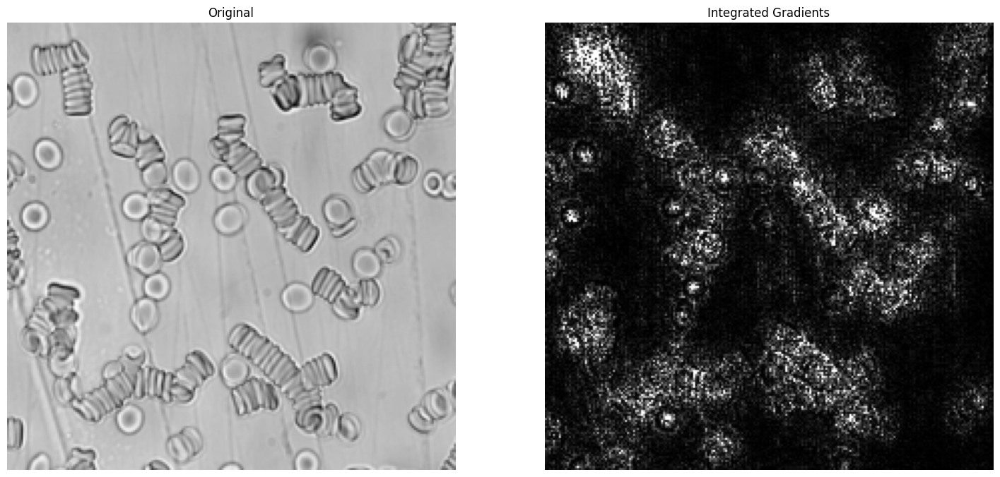

In [116]:
# Set up matplot lib figures.
plt.rcParams["figure.figsize"] = (18, 18)

plt.subplot(1, 2, 1)
plt.title("Original")
plt.imshow(img_t.squeeze(), cmap='gray')
plt.axis("off")

# ShowGrayscaleImage(vanilla_mask.squeeze(), title="Vanilla Gradient", ax=P.subplot(1, 4, 2))
# ShowGrayscaleImage(smoothgrad_mask, title="SmoothGrad", ax=P.subplot(1, 3, 2))
ShowGrayscaleImage(saliency_map, title="Integrated Gradients", ax=P.subplot(1, 2, 2))

plt.show()

id:  0
label: normal
predict normal


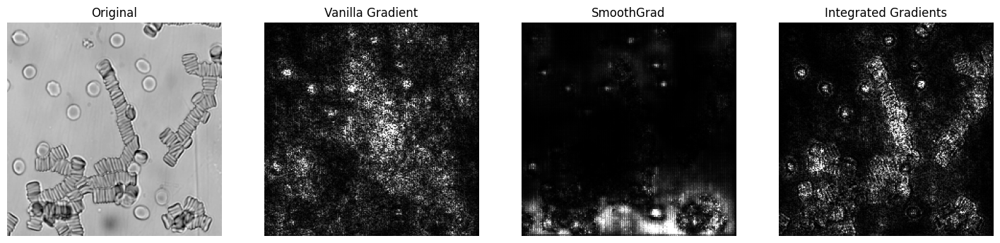

id:  500
label: normal
predict normal


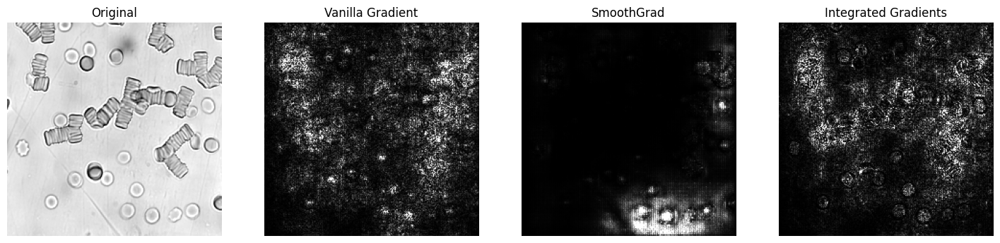

id:  900
label: glytar
predict glytar


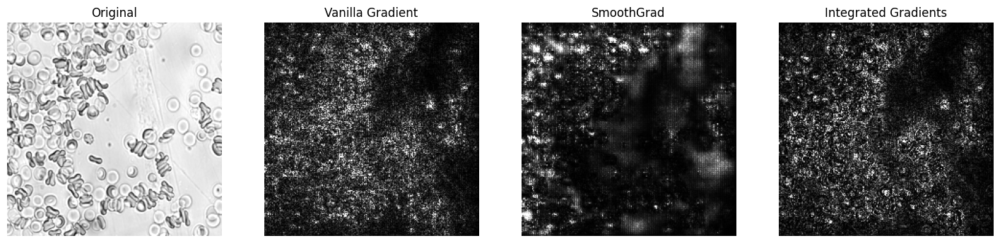

id:  1000
label: glytar
predict glytar


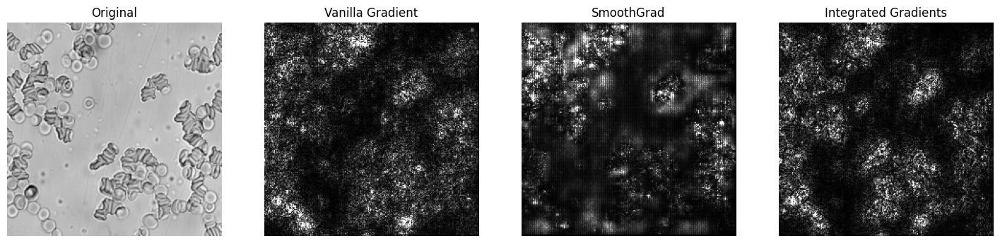

id:  1600
label: dextran
predict dextran


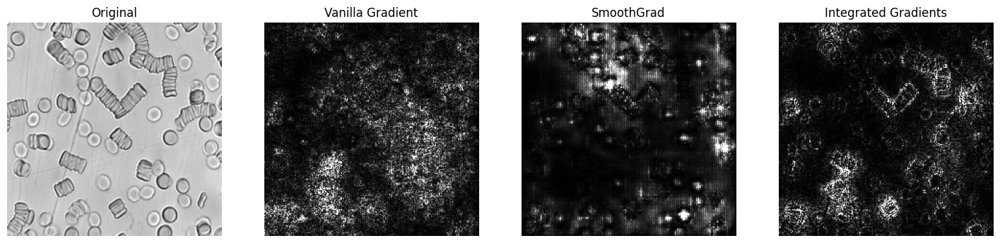

id:  1800
label: dextran
predict dextran


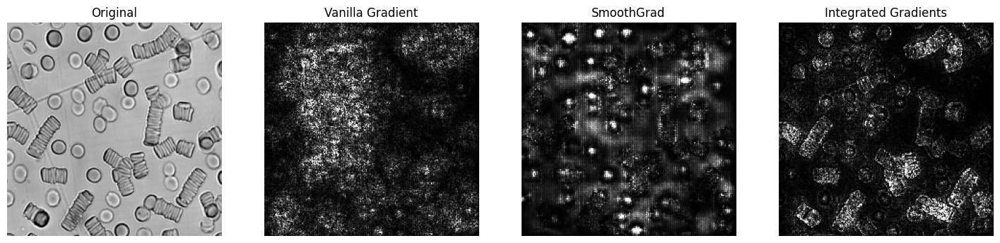

In [117]:
for idx in [0, 500, 900, 1000, 1600, 1800]:
    print('id: ', idx)
    img_t, label = train_data_60x_224[idx]
    img = img_t.numpy()
    name = id2label[label]
    print('label:', name)
    predict_idx = predict(img_t.unsqueeze(dim=0))
    print('predict', id2label[predict_idx])

    gradient_saliency = saliency.GradientSaliency()

    vanilla_mask = gradient_saliency.GetMask(img, call_model_function).squeeze()
    vanilla_mask = grad_to_image(vanilla_mask)

    smoothgrad_mask = gradient_saliency.GetSmoothedMask(img, call_model_function, stdev_spread=.03, nsamples=100, magnitude=True).squeeze()
    smoothgrad_mask = grad_to_image(smoothgrad_mask)

    integrated_gradients = IntegratedGradients(model)
    attributions_ig = integrated_gradients.attribute(img_t.unsqueeze(dim=0).to(device), target=predict_idx, n_steps=128)
    attributions_ig = attributions_ig.cpu().numpy().squeeze().squeeze()
    saliency_map = grad_to_image(attributions_ig)
    
    # Set up matplot lib figures.
    plt.rcParams["figure.figsize"] = (18, 5)

    plt.subplot(1, 4, 1)
    plt.title("Original")
    plt.imshow(img_t.squeeze(), cmap='gray')
    plt.axis("off")

    ShowGrayscaleImage(vanilla_mask.squeeze(), title="Vanilla Gradient", ax=P.subplot(1, 4, 2))
    ShowGrayscaleImage(smoothgrad_mask, title="SmoothGrad", ax=P.subplot(1, 4, 3))
    ShowGrayscaleImage(saliency_map, title="Integrated Gradients", ax=P.subplot(1, 4, 4))

    plt.show()

## GradCam, GradCam++

In [43]:
model

EfficientNet(
  (conv_stem): Conv2d(1, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
  (bn1): BatchNormAct2d(
    32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
    (drop): Identity()
    (act): ReLU6(inplace=True)
  )
  (blocks): Sequential(
    (0): Sequential(
      (0): DepthwiseSeparableConv(
        (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (bn1): BatchNormAct2d(
          32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
          (drop): Identity()
          (act): ReLU6(inplace=True)
        )
        (aa): Identity()
        (se): Identity()
        (conv_pw): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn2): BatchNormAct2d(
          16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True
          (drop): Identity()
          (act): Identity()
        )
        (drop_path): Identity()
      )
    )
    (1): Sequent

In [23]:
%pip install -q grad-cam


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip


In [24]:
from pytorch_grad_cam import GradCAM

target_layers = [model._modules["conv_head"]]

cam = GradCAM(model=model, target_layers=target_layers)

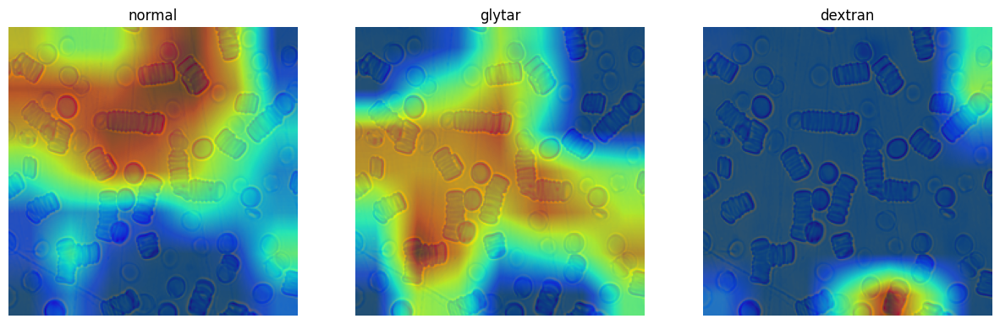

In [25]:
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

plt.figure(figsize=(15, 10))

for n in range(3):
    target = [ClassifierOutputTarget(n)]
    cam_map = cam(input_tensor=img_t.unsqueeze(dim=0), targets=target)

    plt.subplot(1, 3, n + 1)
    plt.imshow(img_t.squeeze())
    plt.imshow(cam_map[0], alpha=0.6, interpolation="bilinear", cmap="jet")
    plt.title(id2label[n])
    plt.axis("off")

plt.show()

In [26]:
from pytorch_grad_cam import GradCAMPlusPlus

target_layers = [model._modules["conv_head"]]
cam_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)

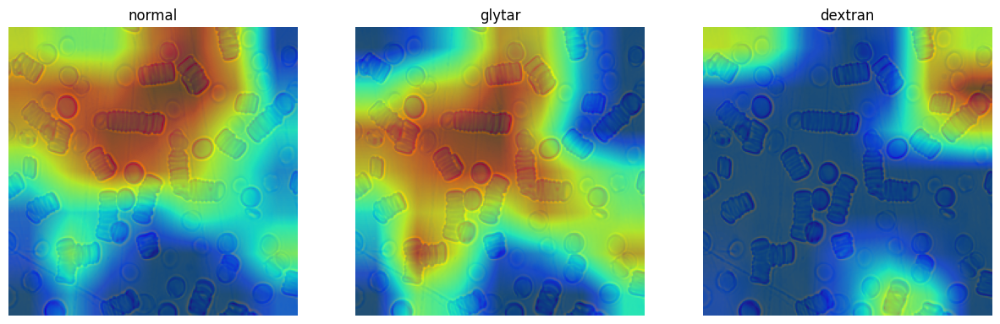

In [27]:
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

plt.figure(figsize=(15, 10))

for n in range(3):
    target = [ClassifierOutputTarget(n)]
    cam_map = cam_plus(input_tensor=img_t.unsqueeze(dim=0), targets=target)

    plt.subplot(1, 3, n + 1)
    plt.imshow(img_t.squeeze())
    plt.imshow(cam_map[0], alpha=0.6, interpolation="bilinear", cmap="jet")
    plt.title(id2label[n])
    plt.axis("off")

plt.show()

## GradCam layers

In [37]:
length = len(val_data_60x_224)
idx = np.random.randint(0, length)
# idx = 10
print('id: ', idx)
img_t, label = val_data_60x_224[idx]
img = img_t.numpy()
name = id2label[label]
print('label:', name)
predict_idx = predict(img_t.unsqueeze(dim=0))
print('predict', id2label[predict_idx])

print('\nPredictons:')
predictions = get_all_predictions(img_t.unsqueeze(dim=0))
print_predictions(predictions)

id:  71
label: normal
predict normal

Predictons:
norma:  0.928
glytar:  0.008
dextran:  0.064


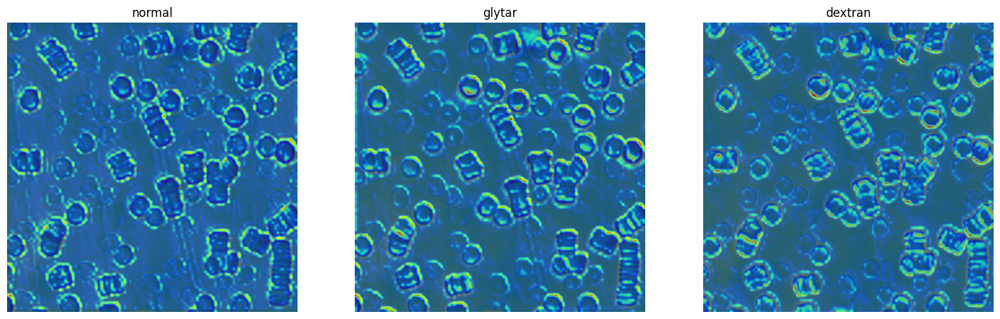

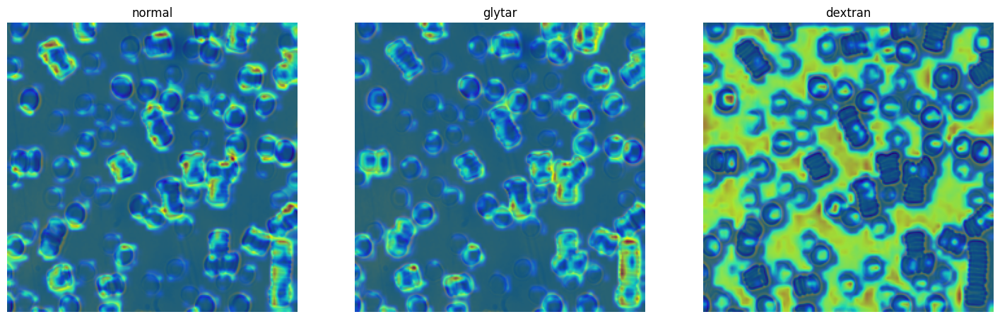

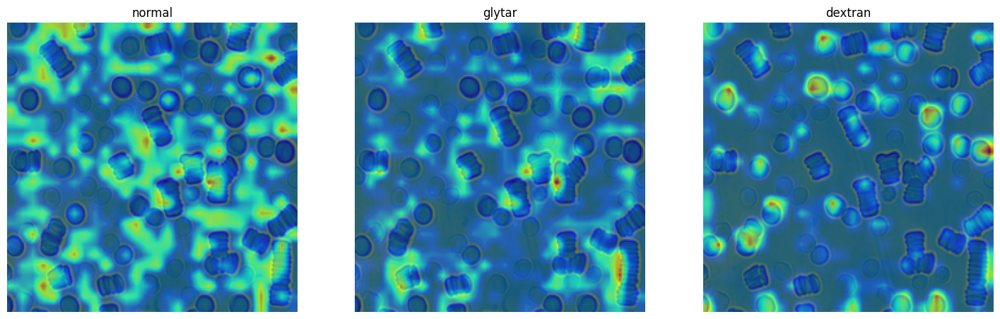

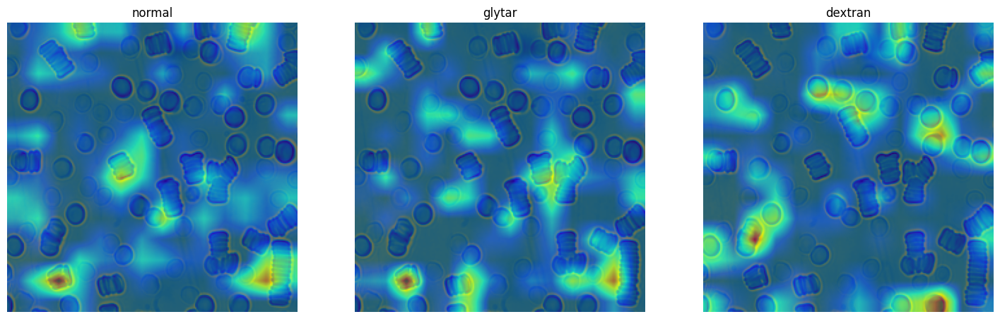

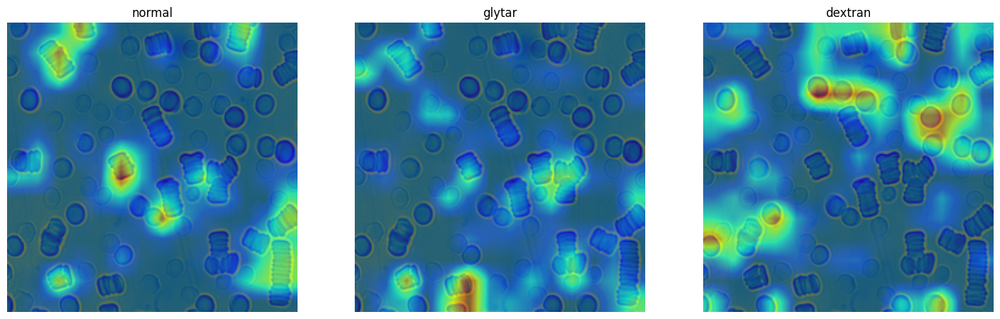

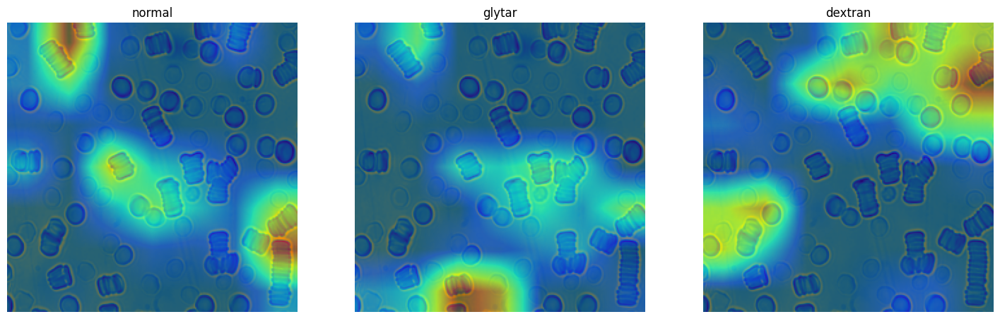

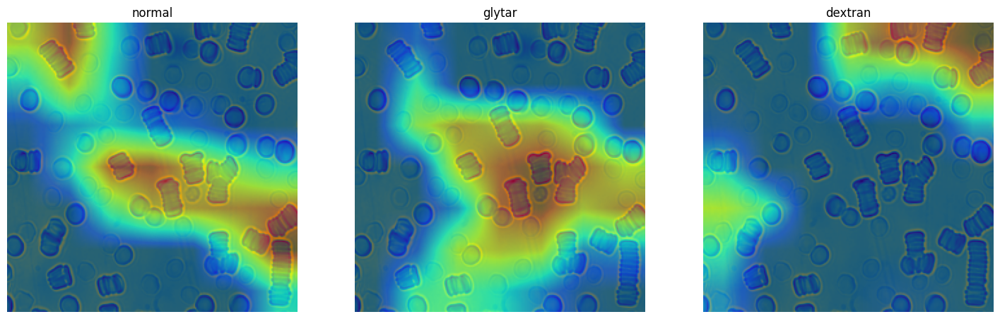

In [38]:
from pytorch_grad_cam import GradCAM


plt.figure(figsize=(5, 5))
plt.title("Original")
plt.imshow(img_t.squeeze(), cmap='gray')
plt.axis("off")
plt.show()

for i in range(7):
    plt.figure(figsize=(18, 18))
    target_layers = [model._modules['blocks'][i][0]]

    cam = GradCAM(model=model, target_layers=target_layers)
    
    for n in range(3):
        target = [ClassifierOutputTarget(n)]
        cam_map = cam(input_tensor=img_t.unsqueeze(dim=0), targets=target)

        plt.subplot(1, 3, n + 1)
        plt.imshow(img_t.squeeze())
        plt.imshow(cam_map[0], alpha=0.5, interpolation="bilinear", cmap="jet")
        plt.title(id2label[n])
        plt.axis("off")
    
    plt.show()

## GradCam++ layers

In [47]:
length = len(val_data_60x_224)
idx = np.random.randint(0, length)
# idx = 10
print('id: ', idx)
img_t, label = val_data_60x_224[idx]
img = img_t.numpy()
name = id2label[label]
print('label:', name)
predict_idx = predict(img_t.unsqueeze(dim=0))
print('predict', id2label[predict_idx])

print('\nPredictons:')
predictions = get_all_predictions(img_t.unsqueeze(dim=0))
print_predictions(predictions)

id:  466
label: glytar
predict glytar

Predictons:
norma:  0.000
glytar:  1.000
dextran:  0.000


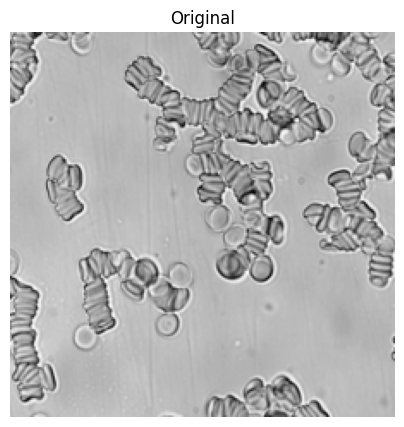

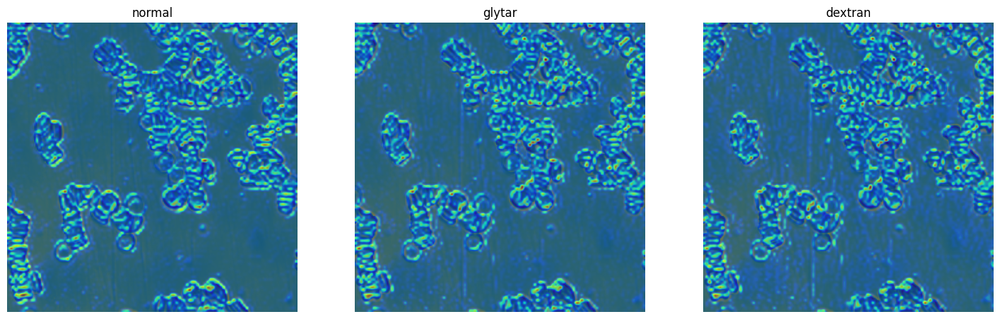

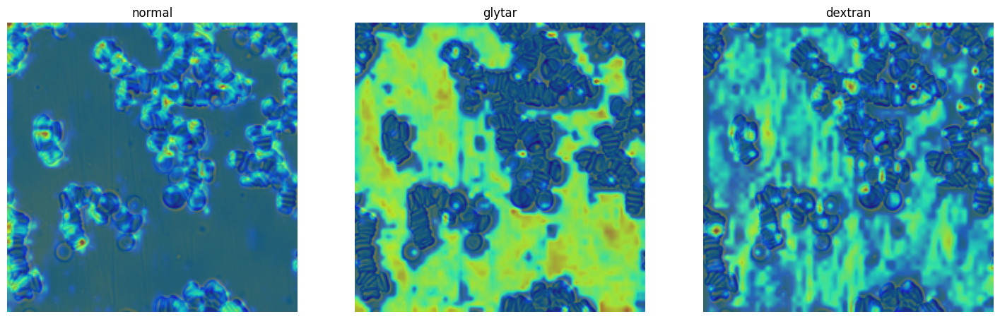

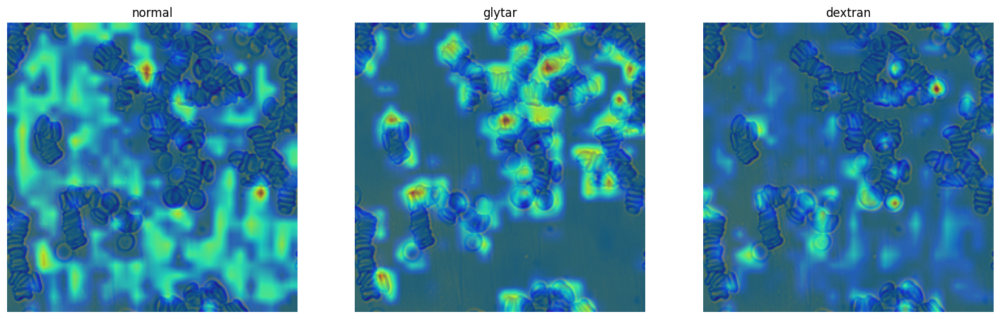

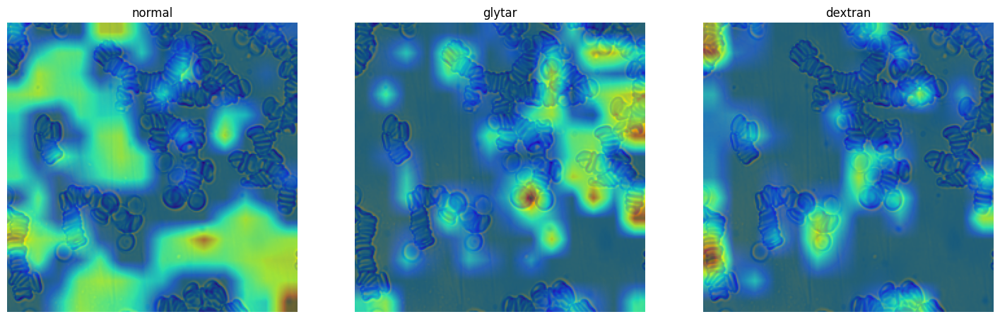

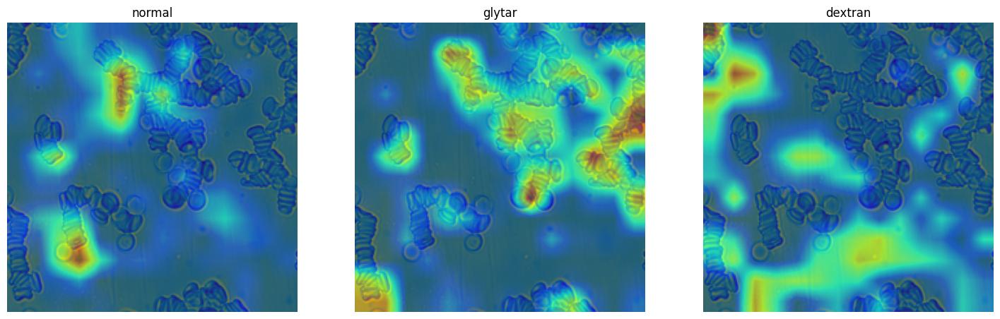

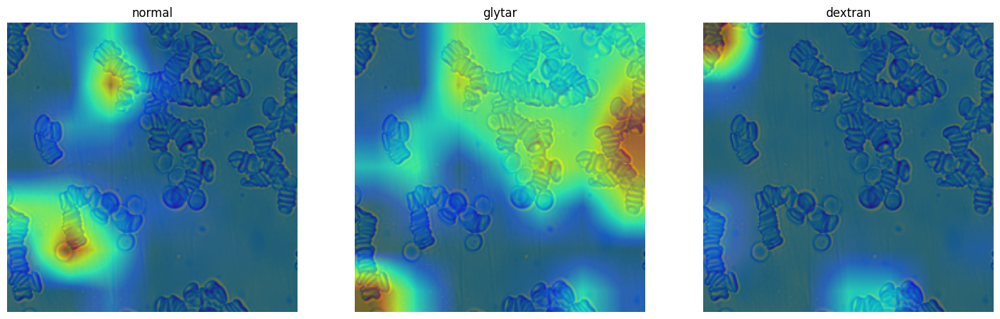

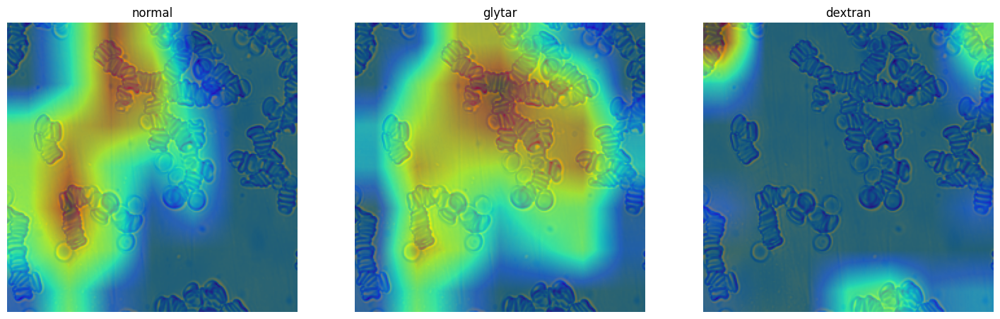

In [48]:
from pytorch_grad_cam import GradCAMPlusPlus


plt.figure(figsize=(5, 5))
plt.title("Original")
plt.imshow(img_t.squeeze(), cmap='gray')
plt.axis("off")
plt.show()

for i in range(7):
    plt.figure(figsize=(18, 18))
    target_layers = [model._modules['blocks'][i][0]]
    # target_layers = [model._modules['blocks'][i]._modules['0']._modules['conv_dw']]
    # target_layers = [model._modules['blocks'][i]._modules['0']._modules['conv_pw']]

    cam_plus = GradCAMPlusPlus(model=model, target_layers=target_layers)
    
    for n in range(3):
        target = [ClassifierOutputTarget(n)]
        cam_map = cam_plus(input_tensor=img_t.unsqueeze(dim=0), targets=target)

        plt.subplot(1, 3, n + 1)
        plt.imshow(img_t.squeeze())
        plt.imshow(cam_map[0], alpha=0.5, interpolation="bilinear", cmap="jet")
        plt.title(id2label[n])
        plt.axis("off")

    plt.show()

# Data visualisation

In [101]:
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib

# matplotlib.style.use("ggplot")

In [103]:
x = []
y = []

id2label = {0: "normal", 1: "glytar", 2: "dextran"}

for i in trange(0, len(train_data_60x_224), 3):
    features = model.forward_features(train_data_60x_224[i][0].unsqueeze(dim=0))[:,::5,::5].reshape(-1).detach().numpy()
    x.append(features)
    y.append(id2label[train_data_60x_224[i][1]] + ' (train)')

for i in trange(0, len(val_data_60x_224), 3):
    features = model.forward_features(val_data_60x_224[i][0].unsqueeze(dim=0))[:,::5,::5].reshape(-1).detach().numpy()
    x.append(features)
    y.append('val/test data')

for i in trange(0, len(test_data_60x_224), 3):
    features = model.forward_features(test_data_60x_224[i][0].unsqueeze(dim=0))[:,::5,::5].reshape(-1).detach().numpy()
    x.append(features)
    y.append('val/test data')

  0%|          | 0/607 [00:00<?, ?it/s]

  0%|          | 0/287 [00:00<?, ?it/s]

  0%|          | 0/151 [00:00<?, ?it/s]

In [104]:
pca_decomposer = PCA(n_components=2)
pca_decomposer.fit(x)
x_reduced_pca = pca_decomposer.transform(x)

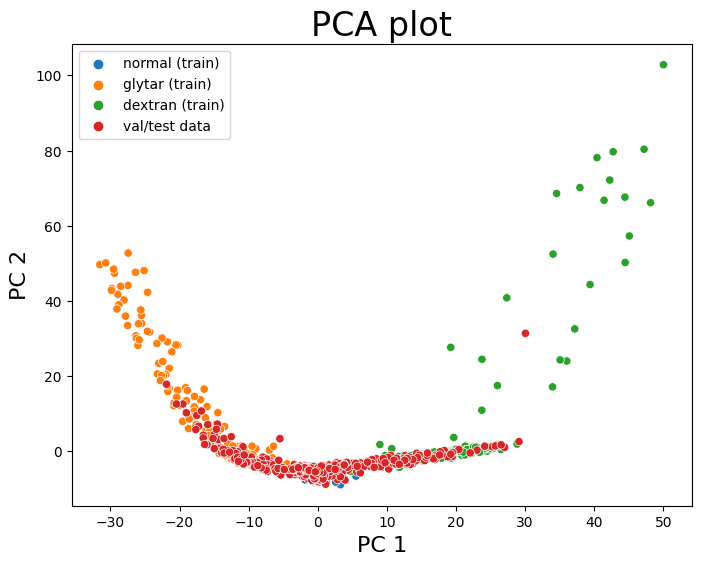

In [105]:
plt.figure(figsize=(8, 6))
plt.title("PCA plot", size=24)
plt.xlabel("PC 1", size=16)
plt.ylabel("PC 2", size=16)
sns.scatterplot(x=x_reduced_pca[:, 0], y=x_reduced_pca[:, 1], hue=y);

In [106]:
%pip install -q umap-learn


[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip


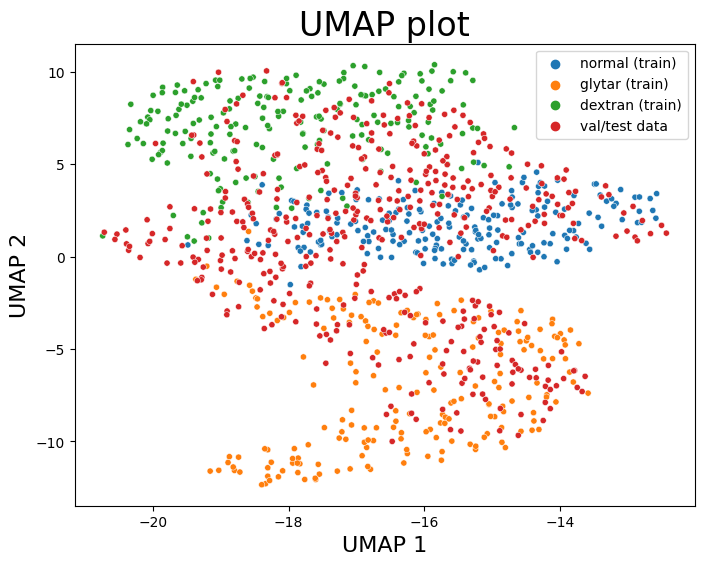

In [107]:
from umap import UMAP
from IPython.display import clear_output

# Converts the original expression matrix (scRNAseq) into a 9-dimensional PCA space
x_reduced_pca = PCA(n_components=2).fit_transform(x)  # x_scRNAseq

# Initializes UMAP with the PCA components
umap_model = UMAP(
    n_components=2,
    min_dist=1,
    n_neighbors=50,
    init=x_reduced_pca,
    # it is recommended to use the first two components of PCA for initialization of UMAP and t-SNE
    n_epochs=1000,
    verbose=2,
)

# Runs the UMAP algorithm on the PCA transformed data
umap = umap_model.fit_transform(x)
clear_output()
# Plots the results of the UMAP transformation
plt.figure(figsize=(8, 6))
plt.title("UMAP plot", size=24)
plt.xlabel("UMAP 1", size=16)
plt.ylabel("UMAP 2", size=16)
sns.scatterplot(x=umap[:, 0], y=umap[:, 1], s=20, hue=y, palette='tab10');

# Confusion matrix

## Val

In [13]:
from sklearn.metrics import confusion_matrix

y_true = [el[1] for el in val_data_60x_224]

y_pred = []
length = len(val_data_60x_224)
for idx in trange(length):
    img_t, label = val_data_60x_224[idx]
    img = img_t.numpy()
    predict_idx = predict(img_t.unsqueeze(dim=0))
    y_pred.append(predict_idx)

confusion_matrix(y_true, y_pred)

  0%|          | 0/859 [00:00<?, ?it/s]

array([[253,  54,   5],
       [  0, 270,   0],
       [ 15,   0, 262]])

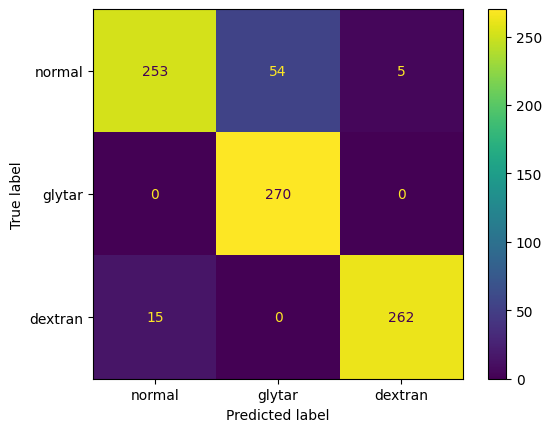

In [16]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
# matplotlib.style.use("default")

cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=id2label.values())
disp.plot()
plt.show()

## Test

In [17]:
y_true = [el[1] for el in test_data_60x_224]

y_pred = []
length = len(test_data_60x_224)
for idx in trange(length):
    img_t, label = test_data_60x_224[idx]
    img = img_t.numpy()
    predict_idx = predict(img_t.unsqueeze(dim=0))
    y_pred.append(predict_idx)

confusion_matrix(y_true, y_pred)

  0%|          | 0/451 [00:00<?, ?it/s]

array([[146,   0,   1],
       [ 15, 138,   1],
       [ 72,   2,  76]])

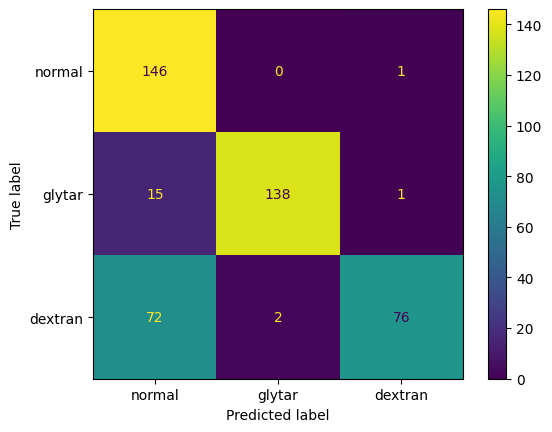

In [18]:
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=id2label.values())
disp.plot()
plt.show()

# Empty GPU memory

In [15]:
import gc

# model.cpu()
# del model
gc.collect()
torch.cuda.empty_cache()